# Implementing Using Color Detection

## Importing Required libraries

In [4]:
import numpy as np 
import cv2 
from matplotlib import pyplot as plt
#from google.colab.patches import cv2_imshow

#from scipy import ndimage 

#from skimage.feature import peak_local_max 
#from skimage.morphology import watershed
#import imutils
#from google.colab import drive
#drive.mount('/content/drive')

path = 'Documents/DataScience/Contour Flooring/images'

### Images

In [5]:
img1 = cv2.imread('1.jpeg') 
# img2 = cv2.imread(path+'/2.jpeg',1) 
# img3 = cv2.imread(path+'/3.jpeg',1) 
# img4 = cv2.imread(path+'/4.jpeg',1) 
# img5 = cv2.imread(path+'/5.jpeg',1) 
# img6 = cv2.imread(path+'/6.jpg',1) 
# img7 = cv2.imread(path+'/7.jpg',1) 
# img8 = cv2.imread(path+'/8.jpg',1) 
# img9 = cv2.imread(path+'/9.jpg',1) 
# img10 = cv2.imread(path+'/10.jpg',1) 
# img11 = cv2.imread(path+'/11.jpg',1) 
# img12 = cv2.imread(path+'/12.jpeg',1) 
# vid1 = cv2.imread(path+'/video1.mp4',1)
print(img1.shape)
cv2.imshow('namei', img1)
cv2.waitKey(0)
cv2.destroyWindow('namei')

(1200, 1600, 3)


### Extracting HSV Values of Floor (Note this will not work in Google Colab as Colab does not support cv2.imshow function)

In [3]:
def nothing(x):
    pass

cv2.namedWindow("Trackbars")
 
cv2.createTrackbar("L - H", "Trackbars", 0, 179, nothing)
cv2.createTrackbar("L - S", "Trackbars", 0, 255, nothing)
cv2.createTrackbar("L - V", "Trackbars", 0, 255, nothing)
cv2.createTrackbar("U - H", "Trackbars", 179, 179, nothing)
cv2.createTrackbar("U - S", "Trackbars", 255, 255, nothing)
cv2.createTrackbar("U - V", "Trackbars", 255, 255, nothing)

while True:
    
    #cv2.imshow('image',img)
    hsv = cv2.cvtColor(img1, cv2.COLOR_BGR2HSV)

    
    l_h = cv2.getTrackbarPos("L - H", "Trackbars")
    l_s = cv2.getTrackbarPos("L - S", "Trackbars")
    l_v = cv2.getTrackbarPos("L - V", "Trackbars")
    u_h = cv2.getTrackbarPos("U - H", "Trackbars")
    u_s = cv2.getTrackbarPos("U - S", "Trackbars")
    u_v = cv2.getTrackbarPos("U - V", "Trackbars")
    
    # set the lower and upper range according to the value selected by the trackbar.
    lower_range = np.array([l_h, l_s, l_v])
    upper_range = np.array([u_h, u_s, u_v])
    
    mask = cv2.inRange(hsv, lower_range, upper_range)
                           
    # optionally you can also show the real part of the target color
    res = cv2.bitwise_and(img1, img1, mask=mask)
                           
    mask_3 = cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR)
                           
    # stack all vrames and show it
    stacked = np.hstack((mask_3,img1,res))
    cv2.imshow('Trackbars',cv2.resize(stacked,None,fx=0.4,fy=0.4))
 
    key = cv2.waitKey(1)
    if key == 27:
        break
        
    if key == ord('s'):
        thearray = [[l_h,l_s,l_v],[u_h, u_s, u_v]]
        print(thearray)
        
        # Also save this array as drum.npy
        np.save(path+'/drumval',thearray)
        break
    
cv2.destroyAllWindows()


In [11]:
def find_floor_hsv(img):  
  # This variable determines if we want to load color range from memory or use the ones defined in notebook. 
  useload = False

  # If true then load color range from memory
  if useload:
      drumval = np.load('media/m12/drumval.npy')

  # kernel for morphological operations
  kernel = np.ones((5,5),np.uint8)

  #while(1):

  # Convert BGR to HSV
  hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

  # If you're reading from memory then load the upper and lower ranges from there
  if useload:
          lower_range = drumval[0]
          upper_range = drumval[1]

  # Otherwise define your own custom values for upper and lower range.
  else:             
    lower_range  = np.array([23, 21, 57])
    upper_range = np.array([38, 61, 255])

  mask = cv2.inRange(hsv, lower_range, upper_range)

  # perform the morphological operations to get rid of the noise
  mask = cv2.erode(mask,kernel,iterations = 2)
  mask = cv2.dilate(mask,kernel,iterations = 4)


  res = cv2.bitwise_and(img,img, mask= mask)

  mask_3 = cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR)

  # stack all frames and show it
  stacked = np.hstack((mask_3,img,res))
  cv2_imshow(cv2.resize(stacked,None,fx=0.8,fy=0.8))

In [ ]:
find_floor_hsv(img1)

NameError: ignored

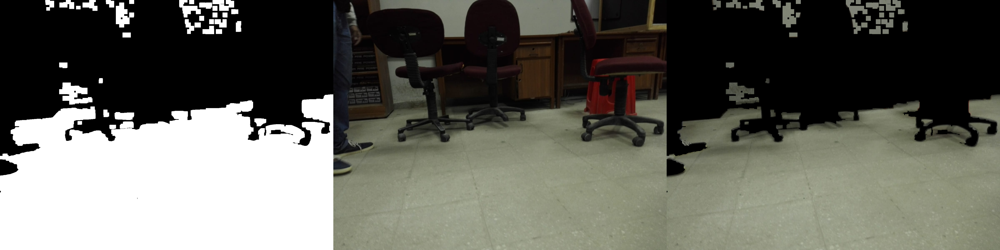

In [ ]:
find_floor_hsv(img2)

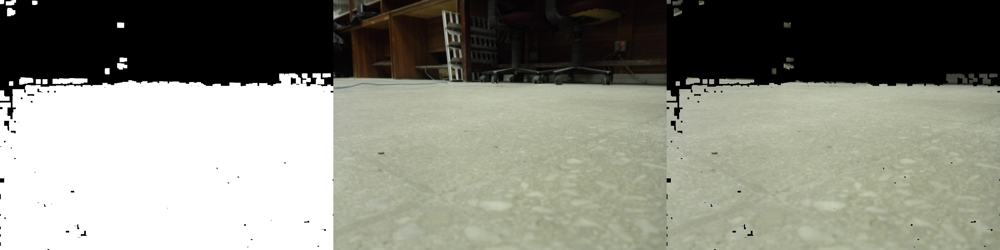

In [ ]:
find_floor_hsv(img3)

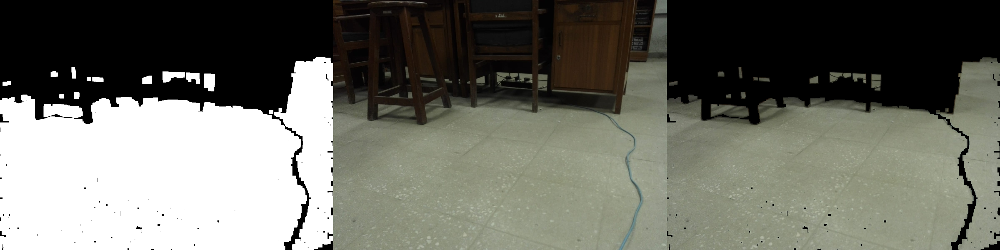

In [ ]:
find_floor_hsv(img4)

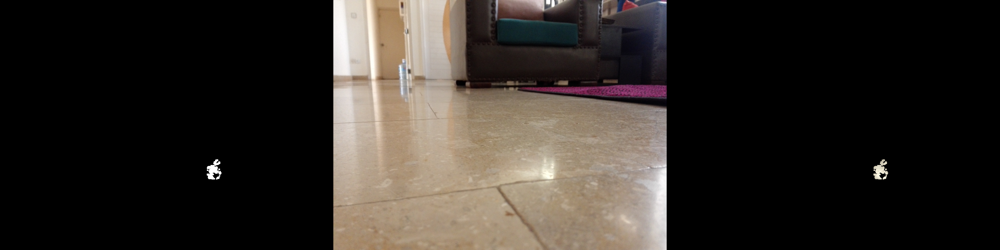

In [ ]:
find_floor_hsv(img6)

# Drawbacks of above approach
1. It cannot be generalized as it uses HSV color values so it will work only on specific floor (as shown in img6)
2. Will not function properly if color of non-floor matches with floor
3. If picture of specific floor is taken from different cameras then it will not function well as color of picture can vary from in different cameras. 

# Flooring and Contour Detection



## Function for Contour Detection

In [ ]:
def Countour_Detection(img):
  """
Detect the floor and contours in the image given as parameter

      Parameters
      ----------
      img : numpy array
          The image to perform action on 
  
  """

  # Perform Bilateral Blur on the image to remove noise from the image

  smoothed = cv2.bilateralFilter(img,19,150,100)

  # Converting image to gray scale

  gray = cv2.cvtColor(smoothed,cv2.COLOR_BGR2GRAY)
  
  # Perform basic Thresholding on the gray scale image
  
  _ , thresh = cv2.threshold(gray, 0, 255,cv2.THRESH_BINARY + cv2.THRESH_OTSU) 
  
  # Making kernal for Morphological Operations which is generally a square with all ones  

  kernel = np.ones((3,3),np.uint8)

  # 

  sure_bg = cv2.erode(thresh,kernel,iterations=10)
  
  # Finding Contours in the pre-processed image

  contours, hierarchy = cv2.findContours(sure_bg,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
  
  # Initializing mask of same shape as the image with all zeros
  
  mask = np.zeros(img.shape, np.uint8)
  
  # storing contour with greatest area in a variable.
  
  c = max(contours, key = cv2.contourArea)

  # Draw Contours on the image

  cv2.drawContours(mask, [c],-1 , (255,255,255), cv2.FILLED)
  
  # Anding mask and image to get the flooring area of the image
  
  mask = cv2.bitwise_and(img,mask,mask=None)
  mask = cv2.cvtColor(mask,cv2.COLOR_BGR2GRAY)
  
  orig = mask.copy()
  #final = np.hstack((orig,img))
  corners = cv2.goodFeaturesToTrack(mask,50,0.01,10) 
  corners = np.int0(corners)
  a = np.array((mask.shape[1],mask.shape[0]))
  
  max_dist=0
  max_ind=0,0
  for i in corners:

    # break the array to x and y points 
    x,y = i.ravel()
    z=a[1]-y
    b=np.array((x,z))
    dist = np.linalg.norm(a-b)
    if dist>max_dist:
      max_dist=dist
      max_ind=x,y
  cv2.circle(mask,max_ind,6,255,-1)
    
  #print(max_dist)
  
  # Plotting original image and final image

  #fig = plt.figure(figsize=(15, 15))
 # plt.subplot(121);plt.imshow(img[:,:,::-1]);plt.title("Original Image");
  #plt.subplot(122);plt.imshow(mask[:,:],cmap='gray');plt.title("Final Image");

  return mask



In [ ]:
#Initilize Video capture Object and points towards a video file 
cap = cv2.VideoCapture(path+'/video1.mp4')
fourcc = cv2.VideoWriter_fourcc(*'MP4V')
out = cv2.VideoWriter(path+'/mysavedmovie6.mp4',fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))
# If your capture was not properly initialized , then open it. 
#if not cap.isOpened(): 
#  cap.open('media/M1/vtest.avi')

# Lets print the status of your Capture. 
print('Status:',cap.isOpened())

# Initilize a loop in which we will read video frame by frame 
while(True):

# read frame by frame 
  ret, frame = cap.read()

# if a frame is not read correctly or there are no more frames to be read the 
  if not ret: 
    break
  
  mask = Countour_Detection(frame)

  out.write(mask)

out.release()
cap.release()

Status: True


KeyboardInterrupt: ignored

1652.627302207004


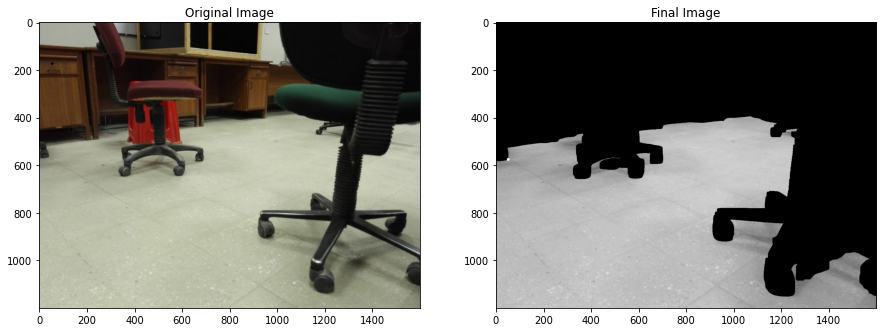

In [ ]:
Countour_Detection(img1)

1735.396208362805


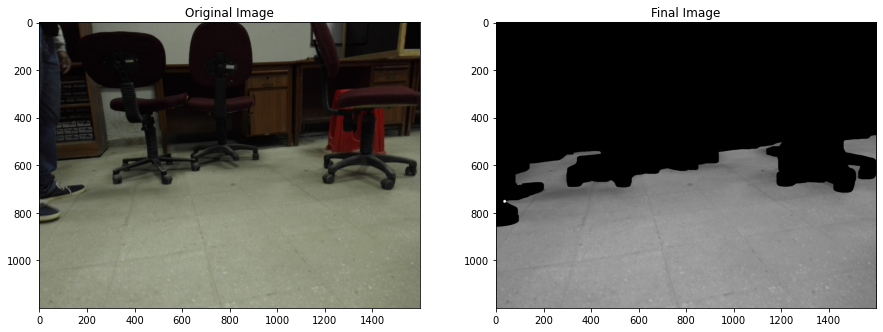

In [ ]:
Countour_Detection(img2)

1682.8764066324063


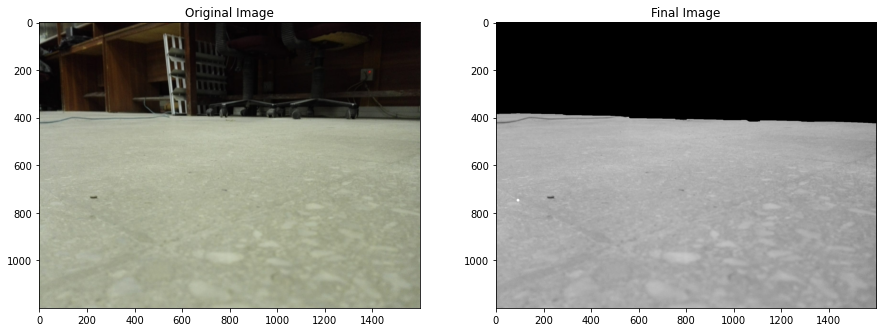

In [ ]:
Countour_Detection(img3)

1558.7280070621687


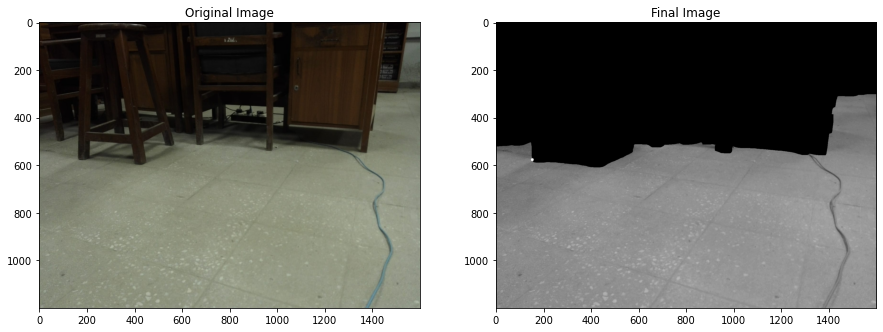

In [ ]:
Countour_Detection(img4)

1096.9138525882513


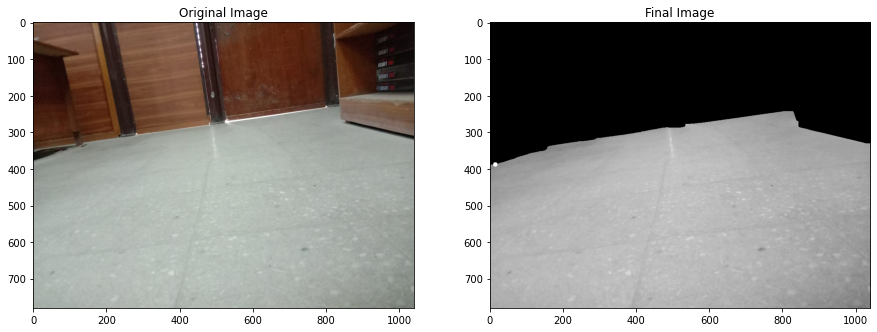

In [ ]:
Countour_Detection(img5)

5144.807187835128


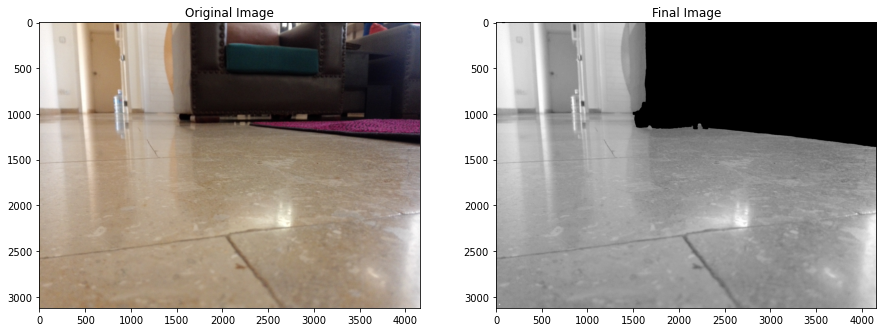

In [ ]:
Countour_Detection(img6)

3583.3683874254402


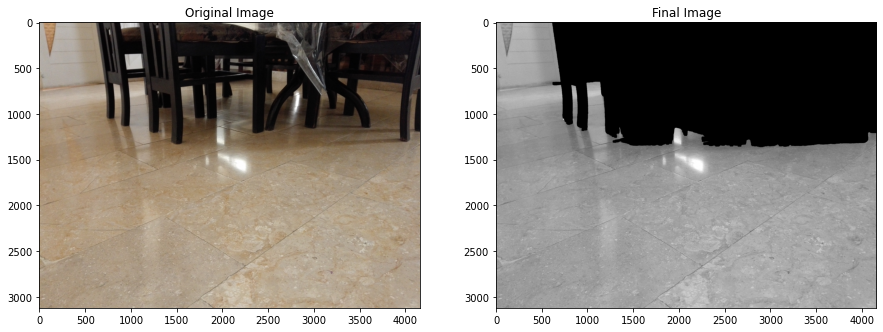

In [ ]:
Countour_Detection(img7)

4187.3812818992255


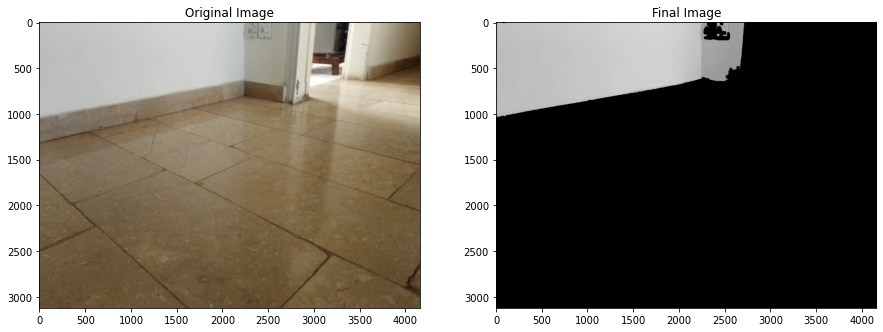

In [ ]:
Countour_Detection(img8)

4143.0120685317825


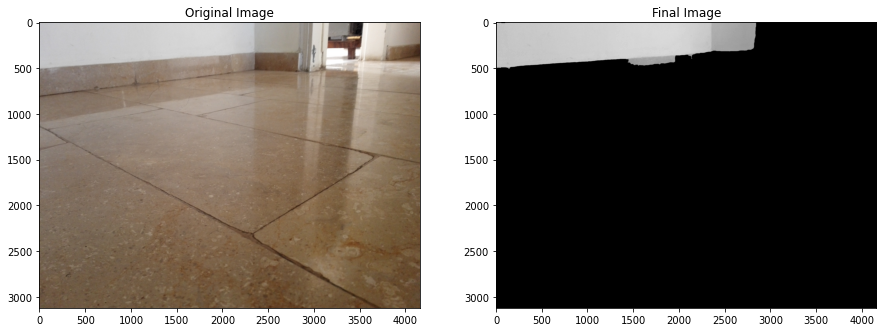

In [ ]:
Countour_Detection(img9)

4730.302527323173


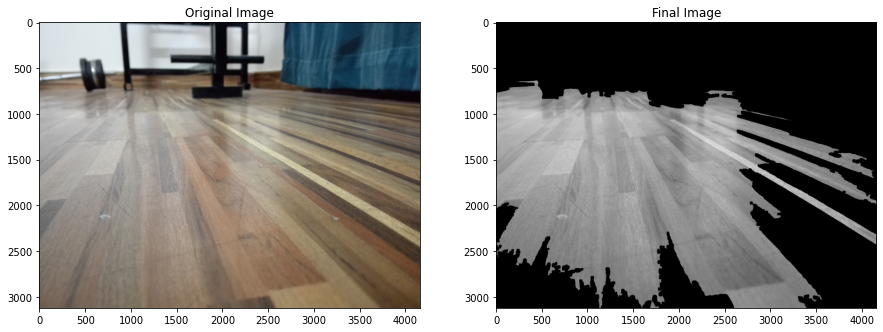

In [ ]:
Countour_Detection(img10)

4212.618425635059


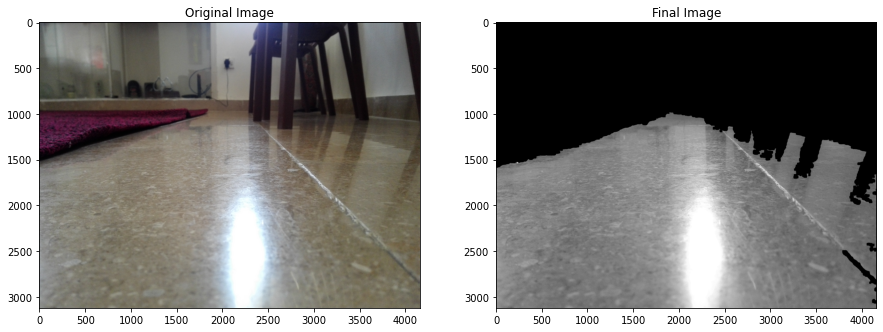

In [ ]:
Countour_Detection(img11)

937.2491664440145


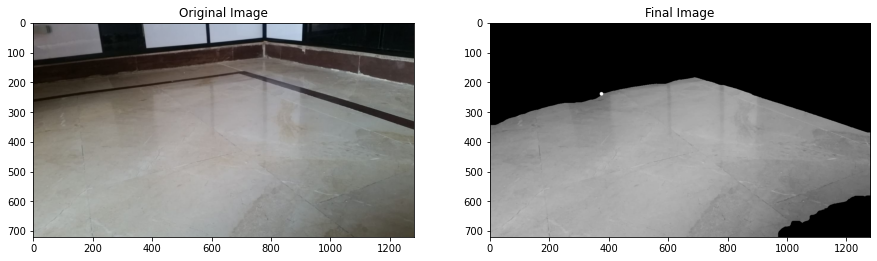

In [ ]:
Countour_Detection(img12)

# Watershed Approach

(600, 800, 3)
(600, 800, 3)


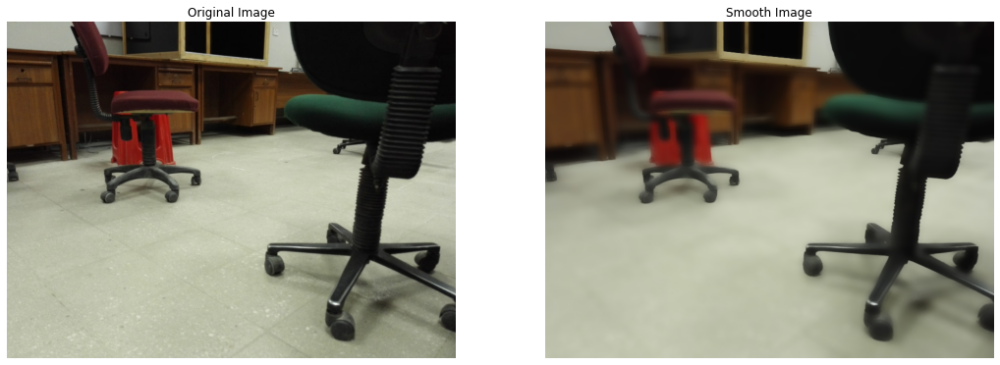

In [ ]:
orig = cv2.resize(img1,None,fx=0.5,fy=0.5)

# This smoothes our image and removes noise
smoothed = cv2.bilateralFilter(orig,19,150,100)

plt.figure(figsize=[18,18])
plt.subplot(121);plt.imshow(orig[:,:,::-1]);plt.title("Original Image");plt.axis('off');
plt.subplot(122);plt.imshow(smoothed[:,:,::-1],cmap='gray');plt.title("Smooth Image");plt.axis('off');1
print(orig.shape)
print(smoothed.shape)

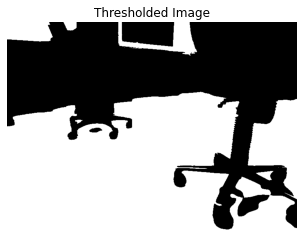

In [ ]:
gray = cv2.cvtColor(smoothed,cv2.COLOR_BGR2GRAY)
_ , thresh = cv2.threshold(gray, 0, 255,cv2.THRESH_BINARY | cv2.THRESH_OTSU)  

plt.imshow(thresh[:,:],cmap='gray');plt.title("Thresholded Image");plt.axis('off');

(600, 800)

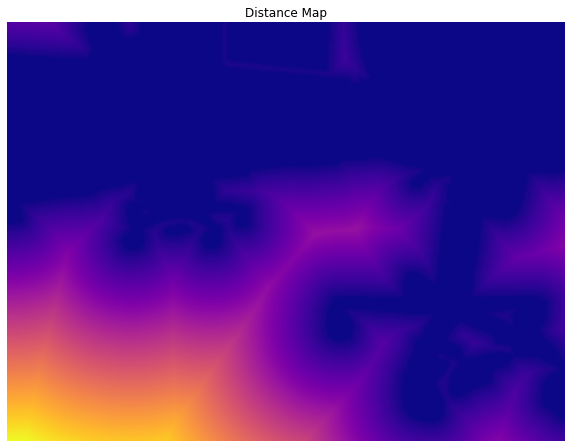

In [ ]:
distance_map = ndimage.distance_transform_edt(thresh)

# Displayig in plasma colormap, Peaks are the brightest, as they are farthest from any background pixel.
plt.figure(figsize=[10,10])
plt.imshow(distance_map[:,:],cmap='plasma');plt.title("Distance Map");plt.axis('off');
thresh.shape

In [ ]:
localMax = peak_local_max(distance_map, indices=False, min_distance=8)
print("Total Peaks Detected: {}".format(sum(sum(localMax == True))))

Total Peaks Detected: 125


In [ ]:
markers, _ = ndimage.label(localMax, structure=np.ones((3, 3)))
print("List of All markers: {} ".format(np.unique(markers)))
markers.shape

List of All markers: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37] 


(600, 800)

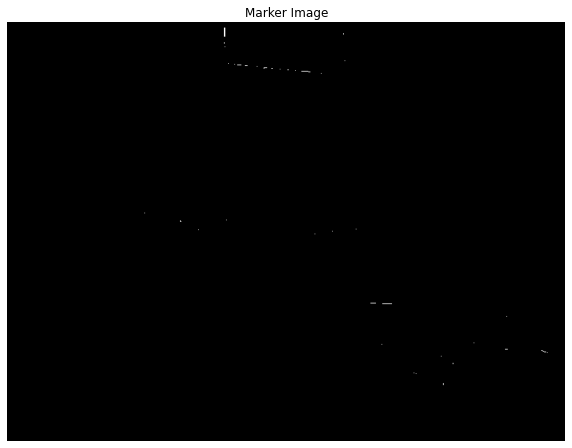

In [ ]:
vismarkers = markers > 0 

plt.figure(figsize=[10,10])
plt.imshow(vismarkers.astype('uint8'),cmap='gray');plt.title("Marker Image");plt.axis('off');

In [ ]:
markers.shape

(600, 800)

In [ ]:
distance_map.shape

(600, 800)

In [ ]:
# Watershed uses the marker and thresholding info.
labels = watershed(-distance_map, markers, mask=thresh)

# -1 because 0 represents background label
print("No of unique segments found: {}".format(len(np.unique(labels)) - 1))

No of unique segments found: 37


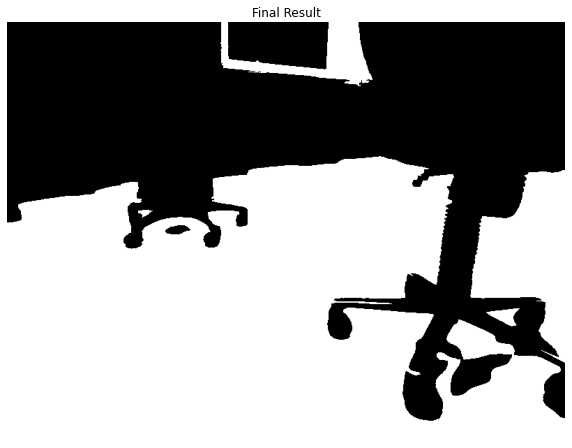

In [ ]:
img = orig.copy()
gray = gray.copy()
# Start looping over each unique label
for label in np.unique(labels):
    
    # Ignore if label == 0 because its background.
    if label == 0:
        continue
    
    # Create a black image of same size as the image
    mask = np.zeros(gray.shape, dtype="uint8")
    # Turn the area white, wherever the target label appears
    mask[labels == label] = 255
    
    # Detect and grab the largest contour
    cnts,hierarchy = cv2.findContours(mask, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    c = max(cnts, key=cv2.contourArea)

    cv2.drawContours(gray,[c],0, (255,255,255), -1)

    ret,th = cv2.threshold(gray,254, 255, cv2.THRESH_BINARY)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (20,20))
    #opening = cv2.morphologyEx(th, cv2.MORPH_OPEN, kernel, iterations=1)

    #cv2.drawContours(img, [c],-1 , (255,255,255), cv2.FILLED)
    #mask = cv2.bitwise_and(img,mask,mask=None)
    # Draw an enclosing circle around the contour, You can choose to draw a bounding box too.
    #((x, y), r) = cv2.minEnclosingCircle(c)
    #cv2.circle(img, (int(x), int(y)), int(r), (200, 55, 0), 2)
    #cv2.putText(img, "#{}".format(label), (int(x) - 10, int(y)),cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 200, 55), 2)

plt.figure(figsize=[10,10])
plt.imshow(th,cmap='gray');plt.title("Final Result");plt.axis('off');
#plt.subplot(121);plt.imshow(img[:,:,::-1]);plt.title("Original Image");
#plt.subplot(122);plt.imshow(mask[:,:,::-1]);plt.title("Final Image");

## Watershed Approach Full Function

In [ ]:
def watershed_func(img):
  orig = cv2.resize(img, None,fx=0.5,fy=0.5)
  smoothed = cv2.bilateralFilter(orig,19,150,100)

  gray = cv2.cvtColor(smoothed,cv2.COLOR_BGR2GRAY)
  _ , thresh = cv2.threshold(gray, 0, 255,cv2.THRESH_BINARY + cv2.THRESH_OTSU) 
  kernel = np.ones((3,3),np.uint8)
  sure_bg = cv2.erode(thresh,kernel,iterations=5)

  distance_map = ndimage.distance_transform_edt(sure_bg)
  localMax = peak_local_max(distance_map, indices=False, min_distance=3) 
  markers, _ = ndimage.label(localMax, structure=np.ones((3, 3))) 
  # Watershed uses the marker and thresholding info. 
  labels = watershed(-distance_map, markers, mask=thresh)

  print("No of unique segments found: {}".format(len(np.unique(labels)) - 1))
  #plt.imshow(labels)
  #plt.figure(figsize=[18,18])

  for label in np.unique(labels):
      
      # Ignore if label == 0 because its background.
      if label == 0:
          continue
      
      # Create a black image of same size as the image
      mask = np.zeros(gray.shape, dtype="uint8")
      # Turn the area white, wherever the target label appears
      mask[labels == label] = 255
      
      # Detect and grab the largest contour
      cnts,hierarchy = cv2.findContours(mask, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
      c = max(cnts, key=cv2.contourArea)

      cv2.drawContours(gray,[c],0, (255,255,255), -1)

      ret,th = cv2.threshold(gray,254, 255, cv2.THRESH_BINARY)
      kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (20,20))
      res = cv2.morphologyEx(th, cv2.MORPH_OPEN, kernel, iterations=1)

  #res= cv2.cvtColor(res, cv2.COLOR_GRAY2BGR)
  #stacked = np.hstack((orig,res))
  #return stacked

  plt.figure(figsize=[15,15])
  #plt.imshow(th,cmap='gray');plt.title("Final Result");plt.axis('off');
  plt.subplot(131);plt.imshow(img[:,:,::-1]);plt.title("Original Image");
  plt.subplot(132);plt.imshow(labels);plt.title("Final Image");
  plt.subplot(133);plt.imshow(res,cmap ='gray');plt.title("Final Image");

  #plt.subplot(121);plt.imshow(orig[:,:,::-1]);plt.title("Original Image");plt.axis('off');
  #plt.subplot(122);plt.imshow(smoothed[:,:,::-1],cmap='gray');plt.title("Smooth Image");plt.axis('off');

No of unique segments found: 44


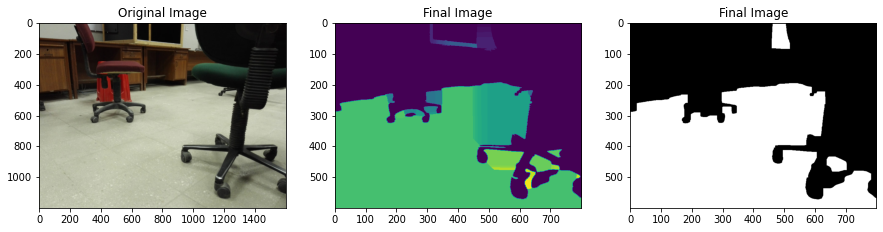

In [ ]:
watershed_func(img1)

No of unique segments found: 33


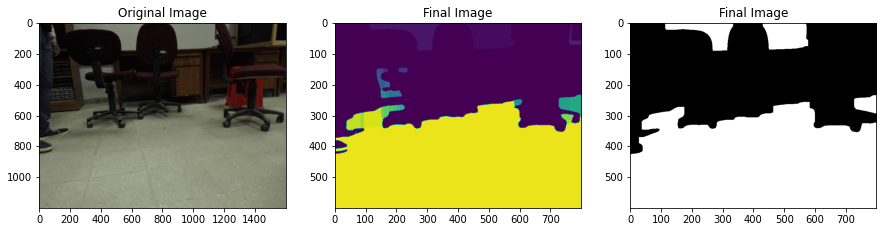

In [ ]:
watershed_func(img2)

No of unique segments found: 7


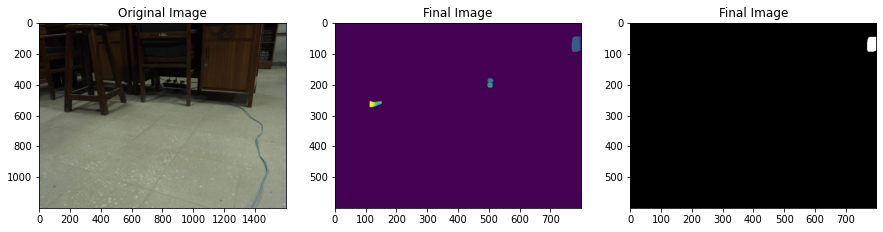

In [ ]:
watershed_func(img4)

No of unique segments found: 42


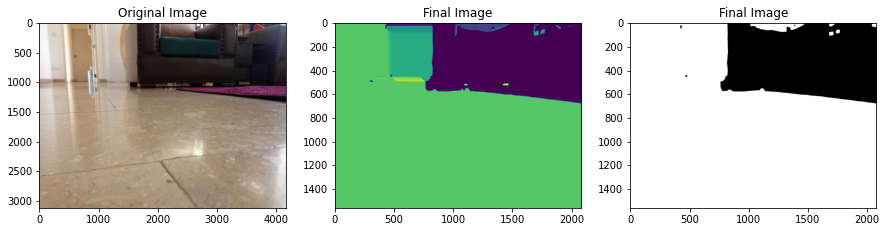

In [ ]:
watershed_func(img6)

No of unique segments found: 142


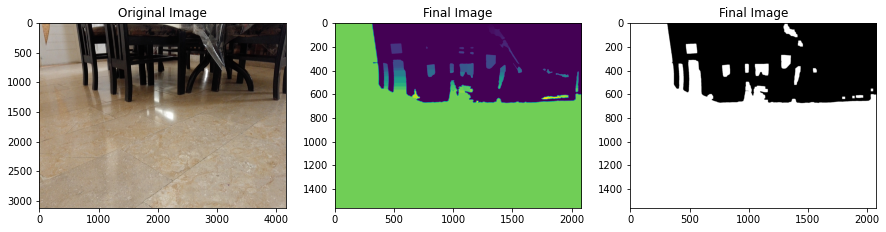

In [ ]:
watershed_func(img7)

No of unique segments found: 119


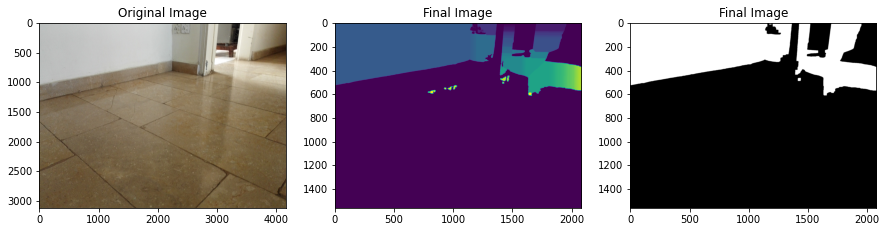

In [ ]:
watershed_func(img8)

No of unique segments found: 170


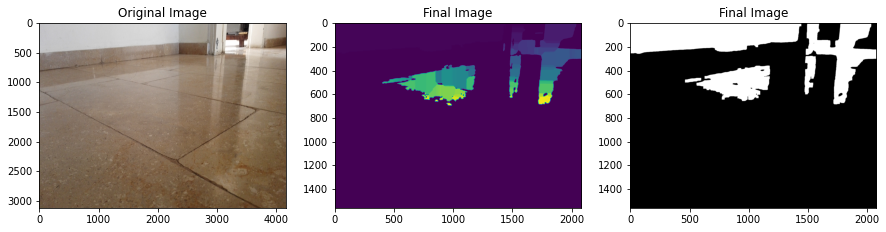

In [ ]:
watershed_func(img9)

No of unique segments found: 569


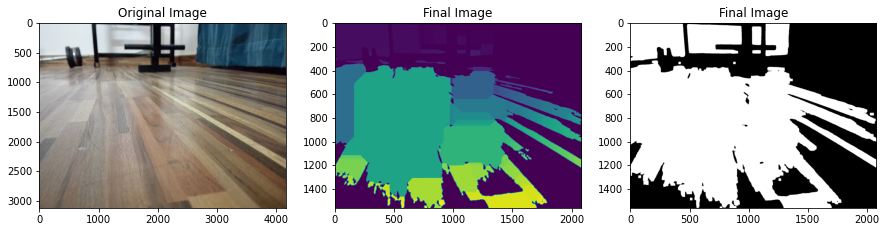

In [ ]:
watershed_func(img10)

No of unique segments found: 195


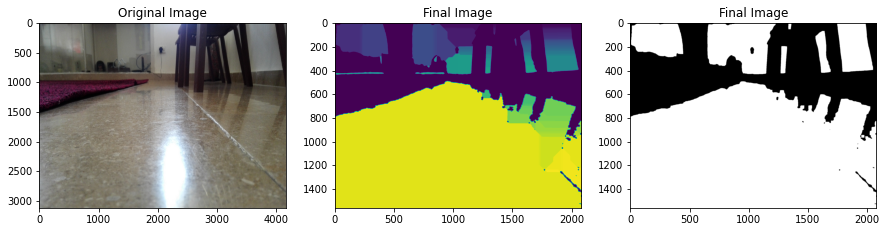

In [ ]:
watershed_func(img11)

No of unique segments found: 51


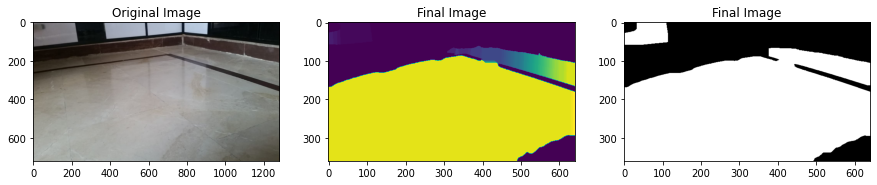

In [ ]:
watershed_func(img12)

In [ ]:


for idx,img_name in enumerate(imglist,1): img = cv2.imread(img_name) orig=img.copy()

gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY) dst = cv2.cornerHarris(gray,2,3,0.04)

#result is dilated for marking the corners, not important 
dst = cv2.dilate(dst,None,iterations=5)

# Threshold for an optimal value, it may vary depending on the image, play wi 
img[dst > 0.01*dst.max()]=[0,0,255] #turn all corner pixels to red

SyntaxError: ignored

# Conclusion

Out of all three approaches we found that Simple Contour Detection with Morphological Operations worked best for us as the results are shown for most of the images. While Marker Based Watershed showed moderate results however in some images Marker Based Watershed worked poorly (example in img5) as it did'nt find any Unique Segments. If we manually provide markers to watershed algorithm, then it will give good results, however, in the apporach we used, markers were detected automatically.

# References
1. https://bleedai.com/

In [6]:
def Countour_Detection(img):
  """
Detect the floor and contours in the image given as parameter

      Parameters
      ----------
      img : numpy array
          The image to perform action on 
  
  """

  # Perform Bilateral Blur on the image to remove noise from the image

  smoothed = cv2.bilateralFilter(img,19,150,100)

  # Converting image to gray scale

  gray = cv2.cvtColor(smoothed,cv2.COLOR_BGR2GRAY)
  
  # Perform basic Thresholding on the gray scale image
  
  _ , thresh = cv2.threshold(gray, 0, 255,cv2.THRESH_BINARY + cv2.THRESH_OTSU) 
  
  # Making kernal for Morphological Operations which is generally a square with all ones  

  kernel = np.ones((3,3),np.uint8)

  # 

  sure_bg = cv2.erode(thresh,kernel,iterations=10)
  
  # Finding Contours in the pre-processed image

  contours, hierarchy = cv2.findContours(sure_bg,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
  
  # Initializing mask of same shape as the image with all zeros
  
  mask = np.zeros(img.shape, np.uint8)
  
  # storing contour with greatest area in a variable.
  
  c = max(contours, key = cv2.contourArea)

  # Draw Contours on the image

  #cv2.drawContours(mask, [c],-1 , (255,255,255), cv2.FILLED)
  
  # Anding mask and image to get the flooring area of the image
  
  #mask = cv2.bitwise_and(img,mask,mask=None)
  #mask = cv2.cvtColor(mask,cv2.COLOR_BGR2GRAY)
  orig = img.copy()
  print(c.shape)
  print(len(c))
  print(c)

  extLeft = tuple(c[c[:, :, 0].argmin()][0])
  extRight = tuple(c[c[:, :, 0].argmax()][0])
  extTop = tuple(c[c[:, :, 1].argmin()][0])
  extBot = tuple(c[c[:, :, 1].argmax()][0])

  cv2.drawContours(orig, [c],-1 , (0,255,255), 20)
  cv2.circle(orig, extLeft, 20, (0, 0, 255), 10)
  cv2.circle(orig, extRight, 20, (0, 255, 0), 10)
  cv2.circle(orig, extTop, 20, (255, 0, 0), 10)
  cv2.circle(orig, extBot, 20, (255, 255, 0), 10)

  
  #orig = mask.copy()
  #final = np.hstack((orig,img))
  #corners = cv2.goodFeaturesToTrack(mask,1,0.01,10) 
  #corners = np.int0(corners)

  # Plotting original image and final image

  fig = plt.figure(figsize=(15, 15))
  plt.subplot(121);plt.imshow(img[:,:,::-1]);plt.title("Original Image");
  plt.subplot(122);plt.imshow(orig[:,:,::-1],);plt.title("Final Image");

(1463, 1, 2)
1463
[[[1060  396]]

 [[1059  397]]

 [[1052  397]]

 ...

 [[1072  397]]

 [[1071  397]]

 [[1070  396]]]


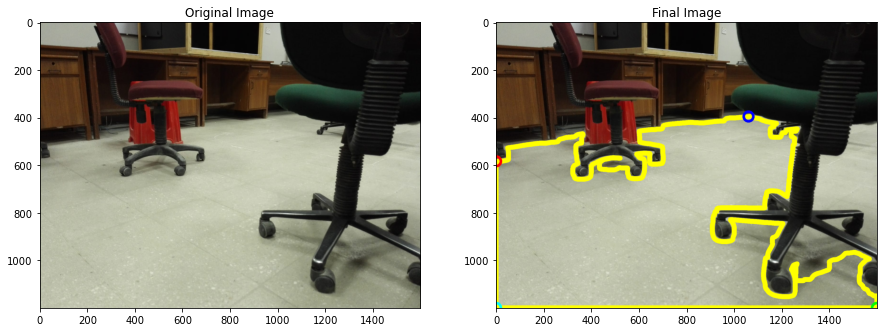

In [7]:
Countour_Detection(img1)

In [ ]:
def Countour_Detection(img):
  """
Detect the floor and contours in the image given as parameter

      Parameters
      ----------
      img : numpy array
          The image to perform action on 
  
  """

  # Perform Bilateral Blur on the image to remove noise from the image

  smoothed = cv2.bilateralFilter(img,19,150,100)

  # Converting image to gray scale

  gray = cv2.cvtColor(smoothed,cv2.COLOR_BGR2GRAY)
  
  # Perform basic Thresholding on the gray scale image
  
  _ , thresh = cv2.threshold(gray, 0, 255,cv2.THRESH_BINARY + cv2.THRESH_OTSU) 
  
  # Making kernal for Morphological Operations which is generally a square with all ones  

  kernel = np.ones((3,3),np.uint8)

  # 

  sure_bg = cv2.erode(thresh,kernel,iterations=10)
  
  # Finding Contours in the pre-processed image

  contours, hierarchy = cv2.findContours(sure_bg,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
  
  # Initializing mask of same shape as the image with all zeros
  
  mask = np.zeros(img.shape, np.uint8)
  
  # storing contour with greatest area in a variable.
  
  c = max(contours, key = cv2.contourArea)

  # Draw Contours on the image

  #cv2.drawContours(mask, [c],-1 , (255,255,255), cv2.FILLED)
  
  # Anding mask and image to get the flooring area of the image
  
  #mask = cv2.bitwise_and(img,mask,mask=None)
  #mask = cv2.cvtColor(mask,cv2.COLOR_BGR2GRAY)
  #orig = img.copy()
  #backtorgb = cv2.cvtColor(mask,cv2.COLOR_GRAY2RGB)
  extLeft = tuple(c[c[:, :, 0].argmin()][0])
  extRight = tuple(c[c[:, :, 0].argmax()][0])
  extTop = tuple(c[c[:, :, 1].argmin()][0])
  extBot = tuple(c[c[:, :, 1].argmax()][0])

  cv2.drawContours(mask, [c],-1 , (255,255,255), -1)
  cv2.circle(mask, extLeft, 20, (0, 0, 255), -1)
  cv2.circle(mask, extRight, 20, (0, 255, 0), -1)
  cv2.circle(mask, extTop, 20, (255, 0, 0), -1)
  cv2.circle(mask, extBot, 20, (255, 255, 0), -1)

  return mask

In [ ]:
Countour_Detection(img1)

In [11]:
#Initilize Video capture Object and points towards a video file 
cap = cv2.VideoCapture+/video1.mp4')
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWritt+'/mysavedmovie.mp4',fourcc, 20.0, (640,480))
# If your capture was not properly initialized , then open it. 
#if not cap.isOpened(): 
#  cap.open('media/M1/vtest.avi')

# Lets print the status of your Capture. 
print('Status:',cap.isOpened())

# Initilize a loop in which we will read video frame by frame 
while(True):

# read frame by frame 
  ret, frame = cap.read()

# if a frame is not read correctly or there are no more frames to be read the 
  if not ret: 
    break
  
  mask = Countour_Detection(frame)

  out.write(mask)

SyntaxError: invalid syntax (<ipython-input-11-618062b27a49>, line 2)

In [10]:
#Initilize Video capture Object and points towards a video file 
cap = cv2.VideoCapture(path+/vide12.mp4')
fourcc = cv2.VideoWriter_fourcc(*'MP4V')
out = cv2.VideoWriter(path+'/mysavedmovie5.mp4',fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))
# If your capture was not properly initialized , then open it. 
#if not cap.isOpened(): 
#  cap.open('media/M1/vtest.avi')

# Lets print the status of your Capture. 
print('Status:',cap.isOpened())

# Initilize a loop in which we will read video frame by frame 
while(True):

# read frame by frame 
  ret, frame = cap.read()

# if a frame is not read correctly or there are no more frames to be read the 
  if not ret: 
    break
  
  mask = Countour_Detection(frame)

  out.write(mask)

out.release()
cap.release()

Status: False
